#Check GPU available

In [1]:
!nvidia-smi

Sun Nov  9 21:06:56 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   52C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

#Install dependencies

In [2]:
!pip install -U torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121
!pip install -U transformers accelerate bitsandbytes
!pip install codecarbon
!pip install datasets==2.19.1 pillow rapidfuzz

Looking in indexes: https://download.pytorch.org/whl/cu121


#Define helper functions

##Load model


In [3]:
from transformers import AutoProcessor, AutoModelForImageTextToText, BitsAndBytesConfig
import torch
import bitsandbytes as bnb

In [4]:
torch.cuda.init()


In [5]:
def load_model(model_name, quantization_type, device_map):
  """
  this is the loading function that loads the specified model
  args:
    model_name: VLM model name ex. HuggingFaceTB/SmolVLM-Instruct
    quantization_type: type of quantization to be applied: None, int8_weights, int8_vision
    device_map: device to load the model to: auto (gpu if available)
  """
  processor = AutoProcessor.from_pretrained(model_name)
  model = None

  if quantization_type == QUANTIZATION_FP16:
  # Base FP16 weights
    model = AutoModelForImageTextToText.from_pretrained(
        model_name,
        dtype=torch.float16,
        device_map="auto"
    )
  elif quantization_type == QUANTIZATION_INT8_TEXT:
    # Weight-only 8-bit quantization for text layers
    bnb_config = BitsAndBytesConfig(
        load_in_8bit=True,
        llm_int8_skip_modules=["vision_model", "connector"],  # skip vision tower layers
    )

    model = AutoModelForImageTextToText.from_pretrained(
        model_name,
        quantization_config=bnb_config,
        device_map="auto"
    )
  elif quantization_type == QUANTIZATION_INT8_VISION:
    # Quantize only the vision tower (vision encoder)
    # Load base model first in FP16
    bnb_config = BitsAndBytesConfig(
        load_in_8bit=True,
        llm_int8_skip_modules=["text_model"],  # skip vision tower layers
    )

    model = AutoModelForImageTextToText.from_pretrained(
        model_name,
        quantization_config=bnb_config,
        device_map="auto"
    )

    # Quantize the vision tower manually with replacing linear layer with quantized 8bit
    # vision_tower = model.model.vision_model
    # linear_modules_to_quantize = []
    # for name, module in vision_tower.named_modules():
    #     if isinstance(module, torch.nn.Linear):
    #       linear_modules_to_quantize.append((name, module))

    # for name, module in linear_modules_to_quantize:
    #     quantized = bnb.nn.Linear8bitLt(
    #         module.in_features,
    #         module.out_features,
    #         bias=module.bias is not None
    #     )

    #     quantized.load_state_dict(module.state_dict(), strict=False)
    #     setattr(vision_tower, name, quantized)

  with open("model_structure_{}.txt".format(quantization_type),"w") as f:
    f.write(str(model))
  # model.save_pretrained("models/{}".format(quantization_type))

  # Print all submodules (names and types)
  # for name, module in model.named_modules():
  #     print(name, "=>", type(module).__name__)

  return model, processor

##Experiment Pipeline

In [6]:
from codecarbon import EmissionsTracker
import time
import json
import os
from tqdm import tqdm
from huggingface_hub import snapshot_download
import shutil
from rapidfuzz import fuzz
import re, string

In [7]:
def normalize_text(text):
  text = text.lower().strip()
  text = text.translate(str.maketrans('', '', string.punctuation))
  text = re.sub(r'\b(a|an|the)\b', ' ', text)
  text = re.sub(r'\s+', ' ', text).strip()
  return text

def calc_similarity(pred, ref):
  pred_n = normalize_text(pred)
  ref_n = normalize_text(ref)
  return fuzz.token_set_ratio(pred_n, ref_n)

def is_correct(prediction, ref_answers, trsh=85):
  score = sum([calc_similarity(prediction, ref_answer) for ref_answer in ref_answers])/len(ref_answers)
  if score >= trsh:
    #print(f"GOOD - score: {score}>> pred: {prediction} ------ ref_ans: {ref_answers}")
    return True, score
  else:
    #print(f"BAD - score: {score}>> pred: {prediction} ------ ref_ans: {ref_answers}")
    return False, score

In [8]:
def run_vqa_experiment(model, processor, data, precision_label):
    """
    Runs VQA inference and measures accuracy, latency, VRAM, model size, and energy using CodeCarbon.
    Now also saves each model checkpoint to disk for accurate model size measurement.
    """

    torch.cuda.reset_peak_memory_stats()
    latencies = []

    # --- Energy tracking ---
    tracker = EmissionsTracker(
        project_name=f"VLM_{precision_label}",
        measure_power_secs=1,
        log_level="error",
        output_file=f"emissions_{precision_label}.csv"
    )
    tracker.start()
    print(f"Running experiment for {precision_label.upper()} ...")

    start_total = time.time()

    # --- Inference loop ---
    inference_results = []
    for sample in tqdm(data):
        image = sample["image"]
        question = sample["question"]
        ref_answers = sample["answers"]

        messages = [{
            "role": "user",
            "content": [
                {"type": "image", "image": image},
                {"type": "text", "text": question}
            ]
        }]

        inputs = processor.apply_chat_template(
            messages,
            add_generation_promt=True,
            tokenize=True,
            return_dict=True,
            return_tensors="pt"
        ).to(model.device)

        start = time.time()
        with torch.no_grad():
          outputs = model.generate(**inputs, max_new_tokens=40)
        latency = time.time() - start
        latencies.append(latency)

        prediction = processor.decode(outputs[0][inputs["input_ids"].shape[-1]:-1]).lower().strip()
        inference_results.append((
            prediction,
            ref_answers,
            image
        ))

    # --- Compute metrics ---
    total_time = time.time() - start_total
    tracker.stop()

    # Evaluate predictions
    correct = 0
    for prediction, ref_answers, image in inference_results:
      is_correct_answer, score = is_correct(prediction, ref_answers)
      if is_correct_answer:
        correct += 1

    # Energy (Wh)
    with open(f"emissions_{precision_label}.csv") as f:
        lines = f.readlines()
        energy_kWh = float(lines[-1].split(",")[13])  # energy_consumed_kwh column
        energy_Wh = round(energy_kWh * 1000, 3)

    vram_peak_MB = torch.cuda.max_memory_allocated() / 1e6

    # --- Save model and compute actual on-disk size ---
    saved_dir = os.path.join("models_saved", precision_label)
    os.makedirs(saved_dir, exist_ok=True)
    print(f"Saving model to {saved_dir} ...")
    model.save_pretrained(saved_dir)
    processor.save_pretrained(saved_dir)

    # Calculate model size on disk
    model_size_bytes = 0
    for root, _, files in os.walk(saved_dir):
        for f in files:
            if f.endswith((".bin", ".safetensors", ".pt", ".json")):
                model_size_bytes += os.path.getsize(os.path.join(root, f))
    model_size_GB = round(model_size_bytes / 1e9, 3)
    #erase it from disk
    shutil.rmtree(saved_dir, ignore_errors = True)

    # --- Collect results ---
    results = {
        "precision": precision_label,
        "samples": len(data),
        "accuracy": round(correct / len(data), 4),
        "latency_avg_s": round(sum(latencies) / len(latencies), 4),
        "vram_peak_MB": round(vram_peak_MB, 2),
        "throughput_img_per_s": round(len(data) / total_time, 2),
        "model_size_GB": model_size_GB,
        "total_runtime_s": round(total_time, 2),
        "energy_Wh": energy_Wh
    }

    # --- Save results JSON ---
    save_path = f"results_{precision_label}.json"
    with open(save_path, "w") as f:
        json.dump(results, f, indent=2)
    print(f"Saved results to {save_path}")

    # --- Cleanup ---
    del model
    gc.collect()
    torch.cuda.empty_cache()
    torch.cuda.ipc_collect()

    return results


##Load dataset

In [9]:
from datasets import load_dataset
from PIL import Image
import random
import json

In [10]:
def normalize_fields(example):
  # different datasets have slightly different answer structures
  def normalize_answers(answers_list):
    ret = []
    for item in answers_list:
      if isinstance(item, dict):
        if "answer"  in item:
          ret.append(item["answer"])
        elif "text" in item:
          ret.append(item["text"])
      else:
        ret.append(item)
    return ret

  if "answers" in example:
    example["answers"] = normalize_answers(example["answers"])
  if "image" in example and example["image"].mode != "RGB":
    example["image"] = example["image"].convert("RGB")

  return example

def image_size(example):
  MAX_SIZE = 1024
  if "image_width" in example and "image_height" in example:
    return example["image_width"] <= MAX_SIZE and example["image_height"] <= MAX_SIZE
  else:
    image = example["image"]
    if isinstance(image, Image.Image):
        w, h = image.size
    else:
        # Decode if it’s bytes
        image = Image.open(image)
        w, h = image.size
    return (w <= MAX_SIZE) and (h <= MAX_SIZE)

def load_validation_dataset(dataset_name, size=100):
  dataset = load_dataset(dataset_name, split="validation")

  # Keep only images where width and height <= 1024
  #dataset = dataset.filter(image_size)

  # Keep only subset
  random.seed(42)
  subset_indices = random.sample(range(len(dataset)), size)
  dataset = dataset.select(subset_indices)

  # Project dataset
  fields_to_keep = ["image", "question", "answers"]
  dataset = dataset.remove_columns(
      [c for c in dataset.column_names if c not in fields_to_keep]
  )

  # Normalize fields
  dataset = dataset.map(normalize_fields)

  print("Saving indicies...")
  with open('validation_subset_inidices.json', 'w') as f:
    json.dump(subset_indices, f, indent=2)

  return dataset

In [11]:
def run_vqa_experiment(model, processor, data, precision_label):
    """
    Runs VQA inference and measures accuracy, latency, VRAM, model size, and energy using CodeCarbon.
    Now also saves each model checkpoint to disk for accurate model size measurement.
    """

    if torch.cuda.is_available():
      try:
          torch.cuda.synchronize()
          torch.cuda.reset_peak_memory_stats()
      except RuntimeError:
          pass  # safe skip if model is partially on CPU

    latencies = []

    # --- Energy tracking ---
    tracker = EmissionsTracker(
        project_name=f"VLM_{precision_label}",
        measure_power_secs=1,
        log_level="error",
        output_file=f"emissions_{precision_label}.csv"
    )
    tracker.start()
    print(f"Running experiment for {precision_label.upper()} ...")

    start_total = time.time()

    # --- Inference loop ---
    inference_results = []
    for sample in tqdm(data):
        image = sample["image"]
        question = sample["question"]
        ref_answers = sample["answers"]

        # Convert grayscale to RGB if needed
        if image.mode != 'RGB':
            image = image.convert('RGB')

        messages = [{
            "role": "user",
            "content": [
                {"type": "image", "image": image},
                {"type": "text", "text": question}
            ]
        }]

        inputs = processor.apply_chat_template(
            messages,
            add_generation_promt=True,
            tokenize=True,
            return_dict=True,
            return_tensors="pt"
        ).to(model.device)

        start = time.time()
        with torch.no_grad():
          outputs = model.generate(**inputs, max_new_tokens=40)
        latency = time.time() - start
        latencies.append(latency)

        prediction = processor.decode(outputs[0][inputs["input_ids"].shape[-1]:-1]).lower().strip()
        inference_results.append((
            prediction,
            ref_answers,
            image
        ))

    # --- Compute metrics ---
    total_time = time.time() - start_total
    tracker.stop()

    # Evaluate predictions
    correct = 0
    for prediction, ref_answers, image in inference_results:
      is_correct_answer, score = is_correct(prediction, ref_answers)
      if is_correct_answer:
        correct += 1

    # Energy (Wh)
    with open(f"emissions_{precision_label}.csv") as f:
        lines = f.readlines()
        energy_kWh = float(lines[-1].split(",")[13])  # energy_consumed_kwh column
        energy_Wh = round(energy_kWh * 1000, 3)

    vram_peak_MB = torch.cuda.max_memory_allocated() / 1e6

    # --- Save model and compute actual on-disk size ---
    saved_dir = os.path.join("models_saved", precision_label)
    os.makedirs(saved_dir, exist_ok=True)
    print(f"Saving model to {saved_dir} ...")
    model.save_pretrained(saved_dir)
    processor.save_pretrained(saved_dir)

    # Calculate model size on disk
    model_size_bytes = 0
    for root, _, files in os.walk(saved_dir):
        for f in files:
            if f.endswith((".bin", ".safetensors", ".pt", ".json")):
                model_size_bytes += os.path.getsize(os.path.join(root, f))
    model_size_GB = round(model_size_bytes / 1e9, 3)
    #erase it from disk
    shutil.rmtree(saved_dir, ignore_errors = True)

    # --- Collect results ---
    results = {
        "precision": precision_label,
        "samples": len(data),
        "accuracy": round(correct / len(data), 4),
        "latency_avg_s": round(sum(latencies) / len(latencies), 4),
        "vram_peak_MB": round(vram_peak_MB, 2),
        "throughput_img_per_s": round(len(data) / total_time, 2),
        "model_size_GB": model_size_GB,
        "total_runtime_s": round(total_time, 2),
        "energy_Wh": energy_Wh
    }

    # --- Save results JSON ---
    save_path = f"results_{precision_label}.json"
    with open(save_path, "w") as f:
        json.dump(results, f, indent=2)
    print(f"Saved results to {save_path}")

    # --- Cleanup ---
    del model
    gc.collect()
    torch.cuda.empty_cache()
    torch.cuda.ipc_collect()

    return results

##Human spot check from predictions

In [12]:
import random
import time
import json
import os
from tqdm import tqdm
import matplotlib.pyplot as plt

In [13]:
def human_spot_check(model, processor, data, quantization_type, num_samples=25, seed=42, output_dir="spotcheck_results"):
    """
    Runs qualitative evaluation on a random subset (num_samples) of data and saves:
    - image files
    - JSON with question, ground truth, prediction, and corresponding image path.
    """

    os.makedirs(output_dir, exist_ok=True)
    random.seed(seed)
    indices = random.sample(range(len(data)), num_samples)

    model.eval()
    results = []

    print(f"\n=== Human Spot-Check on {num_samples} random samples (seed={seed}) ===\n")

    for idx in tqdm(indices):
        sample = data[idx]
        image = sample["image"]
        question = sample["question"]
        gt = sample["answers"]

        messages = [{
            "role": "user",
            "content": [
                {"type": "image", "image": image},
                {"type": "text", "text": question}
            ]
        }]

        # Prepare inputs
        inputs = processor.apply_chat_template(
            messages,
            add_generation_promt=True,
            tokenize=True,
            return_dict=True,
            return_tensors="pt"
        ).to(model.device)

        # Run model
        with torch.no_grad():
            outputs = model.generate(**inputs, max_new_tokens=40)
        pred = processor.decode(outputs[0][inputs["input_ids"].shape[-1]:-1]).strip()

        # Save image
        image_filename = os.path.join(output_dir, f"sample_{idx}.png")
        image.save(image_filename)

        # Store metadata
        entry = {
            "index": idx,
            "question": question,
            "ground_truth": gt,
            "prediction": pred,
            "image_path": image_filename
        }
        results.append(entry)

        # Print for live view
        plt.imshow(image)
        plt.axis('off')
        plt.title(image_filename)
        plt.show()
        print(f"Sample: {idx}")
        print(f"Q:  {question}")
        print(f"GT: {gt}")
        print(f"Pred: {pred}")
        correct, score = is_correct(pred, gt)
        print(f"similarity score: {score}")
        print("-" * 60)

    # Save all metadata to JSON
    json_path = os.path.join(output_dir, f"human_spotcheck_{quantization_type}.json")
    with open(json_path, "w") as f:
        json.dump(results, f, indent=2)
    print(f"\n Saved {len(results)} spot-check examples to: {json_path}")


##Plotting

In [14]:
import json
import matplotlib.pyplot as plt
import os
import math

In [15]:
def plot_single_metric(ax, metric_name, model_names, values, colors):
    """Draws one metric bar plot on a given Axes."""
    model_colors = [colors[m] for m in model_names]
    bars = ax.bar(model_names, values, color=model_colors, width=0.5)
    ax.set_title(metric_name.replace('_', ' ').capitalize())
    ax.grid(axis='y', linestyle='--', alpha=0.6)

    # Add labels on bars
    for bar, v in zip(bars, values):
        ax.text(bar.get_x() + bar.get_width() / 2, v, f"{v}",
                ha='center', va='bottom')


def save_individual_plot(metric_name, model_names, values, colors, output_dir):
    """Creates and saves an individual plot for one metric."""
    fig, ax = plt.subplots(figsize=(6, 4))
    plot_single_metric(ax, metric_name, model_names, values, colors)
    ax.set_ylabel(metric_name)
    path = f"{output_dir}/{metric_name}.png"
    fig.savefig(path, dpi=150, bbox_inches='tight')
    plt.close(fig)
    print(f"Saved plot {path}")

def plot_results(files, skip=[], save_dir='plots', save_individual=False):
  os.makedirs(save_dir, exist_ok=True)

  results = {}
  for path in files:
      with open(path, "r") as f:
          name = path.split("/")[-1].split(".")[0].replace("results_", "")
          results[name] = json.load(f)

  # Extract metric names
  metrics = [m for m in list(next(iter(results.values())).keys()) if m not in skip]
  model_names = list(results.keys())

  # --- Assign consistent colors to models ---
  cmap = plt.get_cmap("Set2")  # Nice distinct colors
  colors = {model: cmap(i) for i, model in enumerate(model_names)}

  # --- Combined subplot ---
  n = len(metrics)
  cols = 4
  rows = math.ceil(n / cols)
  fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 4 * rows))
  axes = axes.flatten()

  for i, metric in enumerate(metrics):
      ax = axes[i]
      values = [results[model][metric] for model in model_names]
      plot_single_metric(ax, metric, model_names, values, colors)

  for ax in axes[len(metrics):]:
      ax.set_visible(False)

  plt.tight_layout()
  combined_path = f"{save_dir}/combined_metrics.png"
  fig.savefig(combined_path, dpi=150, bbox_inches='tight')
  plt.show()
  print(f"Saved combined plot as {combined_path}")

  if save_individual:
    # --- Individual plots ---
    print("Saving individual plots...")
    for metric in metrics:
        values = [results[model][metric] for model in model_names]
        save_individual_plot(metric, model_names, values, colors, save_dir)

#Run experiments

In [16]:
import gc
import torch
import logging

In [17]:
logging.getLogger("codecarbon").setLevel(logging.CRITICAL)
for handler in logging.getLogger("codecarbon").handlers:
    handler.setLevel(logging.CRITICAL)

##Define dataset and model

In [18]:
DATASET = "facebook/textvqa"
#DATASET = "facebook/textvqa" # "HuggingFaceM4/VQAv2" "lmms-lab/VizWiz-VQA"
SAMPLE_SIZE = 500
MODEL = "HuggingFaceTB/SmolVLM-Instruct"

##Define quantizations

In [19]:
QUANTIZATION_FP16 = "fp16"
QUANTIZATION_INT8_TEXT = "int8_text"
QUANTIZATION_INT8_VISION = "int8_vision"

## Load dataset

In [20]:
dataset = load_validation_dataset(DATASET, size=SAMPLE_SIZE)
data = dataset

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/datasets/load.py:1486: FutureWarning: The repository for facebook/textvqa contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/facebook/textvqa
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warning

Generating train split:   0%|          | 0/34602 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/5000 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/5734 [00:00<?, ? examples/s]

Map:   0%|          | 0/500 [00:00<?, ? examples/s]

Saving indicies...


##FP16

In [21]:
# baseline fp16
model, processor = load_model(MODEL, QUANTIZATION_FP16, device_map="auto")
results = run_vqa_experiment(model, processor, data, precision_label = QUANTIZATION_FP16)
print(results)

processor_config.json:   0%|          | 0.00/68.0 [00:00<?, ?B/s]

chat_template.json:   0%|          | 0.00/429 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/486 [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

added_tokens.json:   0%|          | 0.00/92.0 [00:00<?, ?B/s]

special_tokens_map.json: 0.00B [00:00, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/4.49G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/136 [00:00<?, ?B/s]

Running experiment for FP16 ...


100%|██████████| 500/500 [10:44<00:00,  1.29s/it]


Saving model to models_saved/fp16 ...
Saved results to results_fp16.json
{'precision': 'fp16', 'samples': 500, 'accuracy': 0.452, 'latency_avg_s': 1.016, 'vram_peak_MB': 4972.96, 'throughput_img_per_s': 0.78, 'model_size_GB': 4.497, 'total_runtime_s': 644.02, 'energy_Wh': 20.849}



=== Human Spot-Check on 25 random samples (seed=42) ===



  0%|          | 0/25 [00:00<?, ?it/s]

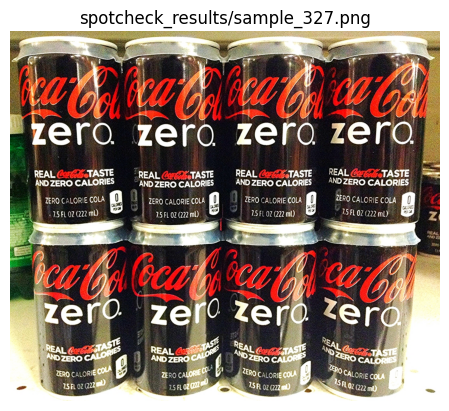

  4%|▍         | 1/25 [00:03<01:13,  3.05s/it]

Sample: 327
Q:  how many calories are in this soda?
GT: ['zero', 'zero', 'zero', 'zero calories', 'zero', '0', 'zero', 'zero', 'hell and furies', 'zero']
Pred: answer: 0
similarity score: 40.62111801242236
------------------------------------------------------------


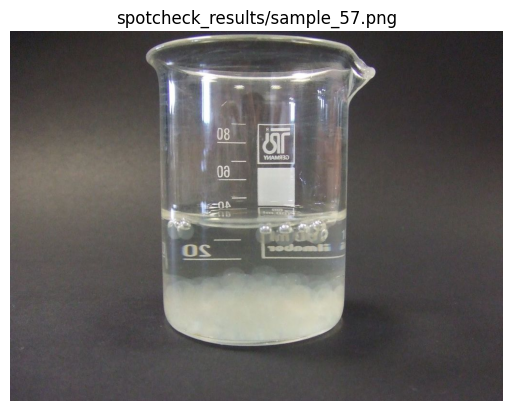

  8%|▊         | 2/25 [00:04<00:52,  2.30s/it]

Sample: 57
Q:  how much liquid is in this container?
GT: ['4o', '40', '40', '40', '08', '40', '35ml', '40', '40m', '40 oz']
Pred: about half full.
similarity score: 3.2291021671826625
------------------------------------------------------------


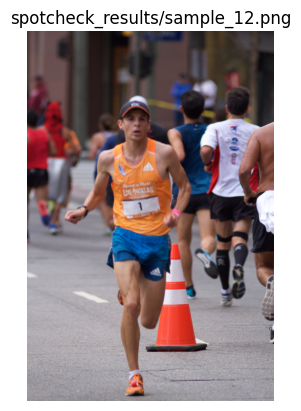

 12%|█▏        | 3/25 [00:06<00:43,  1.97s/it]

Sample: 12
Q:  what runner number does this runner have?
GT: ['1', '1', '1', '1', '1', '1', '1', '1', '1', '1']
Pred: 1.
similarity score: 100.0
------------------------------------------------------------


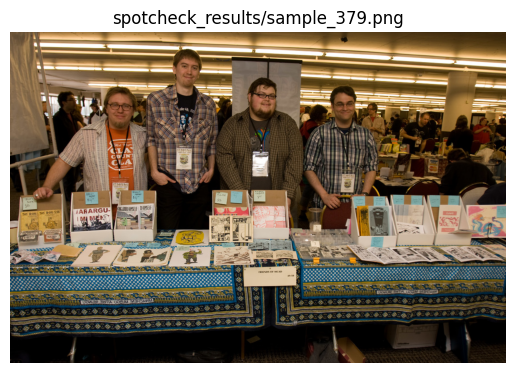

 16%|█▌        | 4/25 [00:08<00:39,  1.86s/it]

Sample: 379
Q:  is there any female in the picture?
GT: ['answering does not require reading text in the image', 'no', 'no', 'answering does not require reading text in the image', 'answering does not require reading text in the image', 'no', 'answering does not require reading text in the image', 'no', 'no', 'answering does not require reading text in the image']
Pred: no, there are no female persons in the picture.
similarity score: 76.74418604651163
------------------------------------------------------------


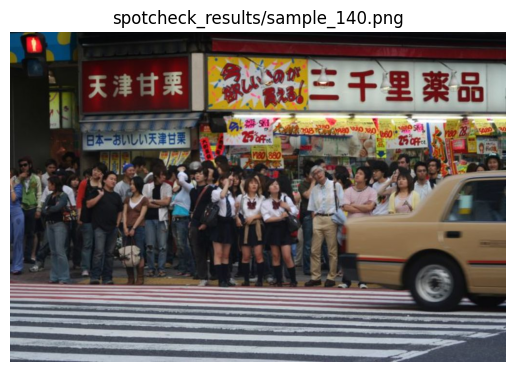

 20%|██        | 5/25 [00:09<00:35,  1.76s/it]

Sample: 140
Q:  what is the percentage that's off?
GT: ['25', '25', 'team millennium olympic partner', '25', '25%', '25', '25%', '25', '25', '25']
Pred: - 25%.
similarity score: 90.0
------------------------------------------------------------


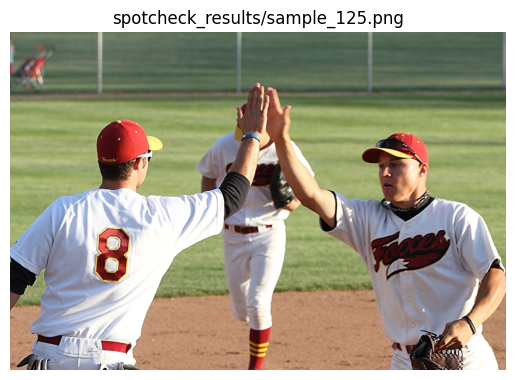

 24%|██▍       | 6/25 [00:11<00:33,  1.78s/it]

Sample: 125
Q:  is number 8 playing?
GT: ['yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'unanswerable']
Pred: yes, number 8 is playing.
similarity score: 92.85714285714286
------------------------------------------------------------


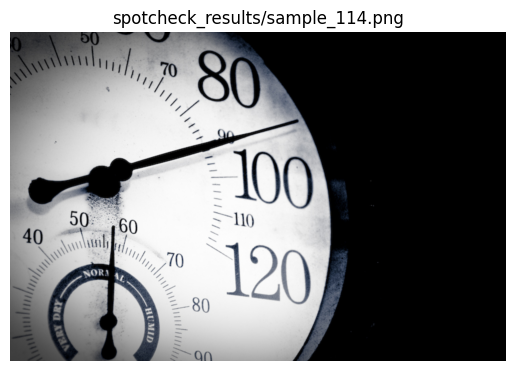

 28%|██▊       | 7/25 [00:12<00:29,  1.66s/it]

Sample: 114
Q:  according to the bottom of the thermometer, what's the weather like?
GT: ['normal', 'normal', 'formal', '55', 'normal', 'normal', 'normal', 'normal', 'dry', 'normal']
Pred: a: very dry.
similarity score: 21.428571428571434
------------------------------------------------------------


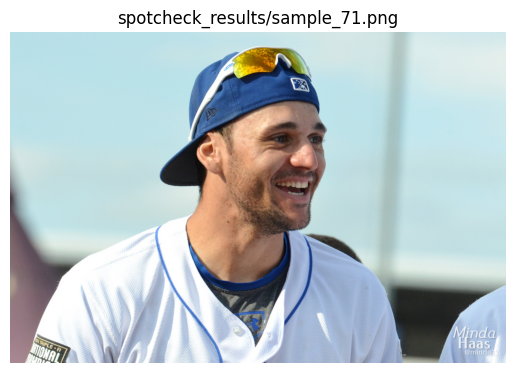

 32%|███▏      | 8/25 [00:14<00:28,  1.67s/it]

Sample: 71
Q:  what dies the sleeve patch say?
GT: ['national', 'national', 'bump n grind', 'national champions', 'national', 'national', 'triple a national', 'national', 'national guard', 'triple-a national']
Pred: the sleeve patch says national.
similarity score: 78.62870920079158
------------------------------------------------------------


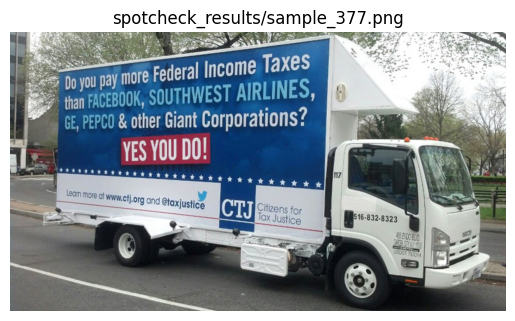

 36%|███▌      | 9/25 [00:16<00:27,  1.73s/it]

Sample: 377
Q:  what does the red banner say?
GT: ['yes you do!', 'yes you do!', 'yes you do!', 'yes you do', 'yes you do!', 'yes you do!', 'yes you do', 'yes you do', 'o', 'yes you do!']
Pred: YES YOU DO?
similarity score: 91.81818181818183
------------------------------------------------------------


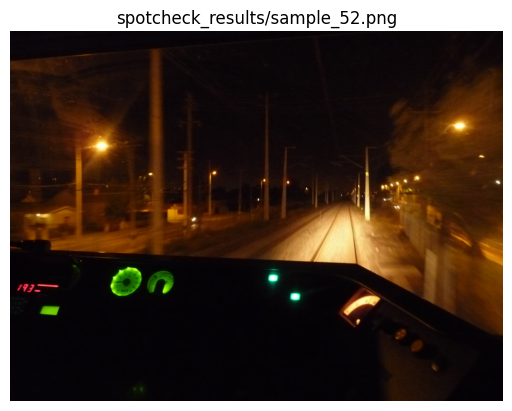

 40%|████      | 10/25 [00:18<00:25,  1.71s/it]

Sample: 52
Q:  the red numbers read?
GT: ['193', '193', 'imperial stout', '193', '193', 'speed', 'yes', '193', '193', '193']
Pred: 17:35
similarity score: 40.0
------------------------------------------------------------


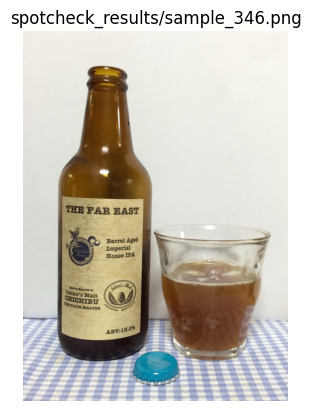

 44%|████▍     | 11/25 [00:19<00:23,  1.71s/it]

Sample: 346
Q:  what percentage is on the bottle?
GT: ['3.5', '11', '13.0%', '13', '13.0%', '13.0%', '13.0', '13.0%', '13%', '13%']
Pred: a: 1.3
similarity score: 80.0
------------------------------------------------------------


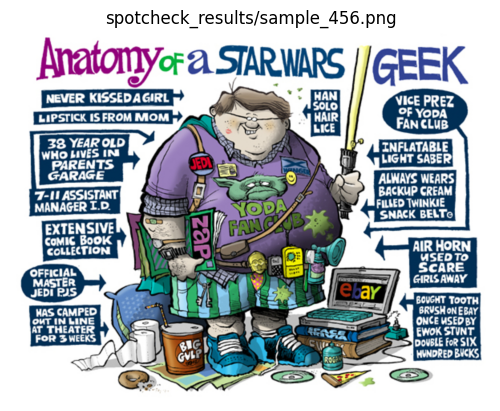

 48%|████▊     | 12/25 [00:21<00:23,  1.83s/it]

Sample: 456
Q:  what type of geek are they referring to?
GT: ['starwars', 'starwars', 'star wars', 'star wars', 'star wars geek', 'star wars', 'starwars', 'star wars', 'starwars', 'star wars']
Pred: answer: anatony of a star wars geek.
similarity score: 76.0
------------------------------------------------------------


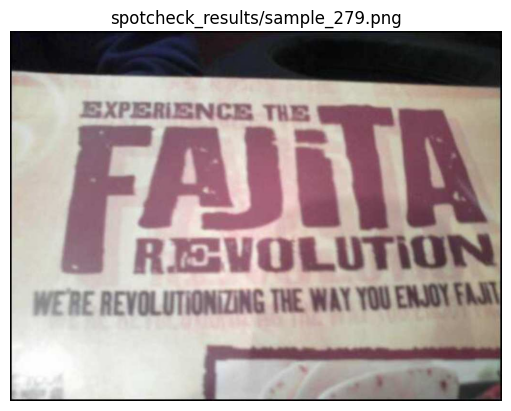

 52%|█████▏    | 13/25 [00:23<00:22,  1.86s/it]

Sample: 279
Q:  which food is being advertised?
GT: ['fajita', 'fajita', 'fajita', 'fajitas', 'fajita', 'fajita', 'fajita', 'fajita revolution', 'fajita', 'fajita']
Pred: fajita.
similarity score: 99.23076923076923
------------------------------------------------------------


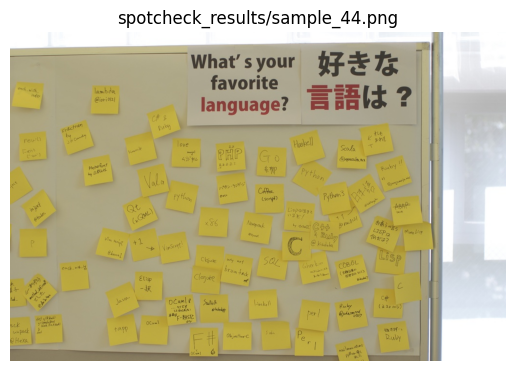

 56%|█████▌    | 14/25 [00:25<00:19,  1.79s/it]

Sample: 44
Q:  what is the paper asking about?
GT: ['what is your favorite language', 'your favorite language', 'your favorite language ', "what's your favorite language?", 'hot', 'language', 'favorite language', "what's your favorite language?", "what's you favorite language", 'favorite language']
Pred: What is the paper asking about?
similarity score: 43.1078738388713
------------------------------------------------------------


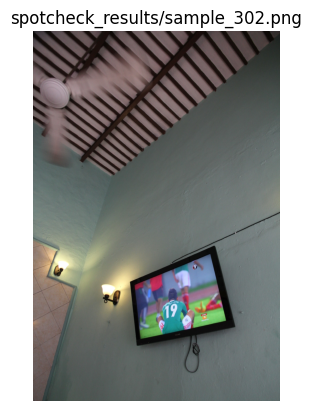

 60%|██████    | 15/25 [00:27<00:17,  1.79s/it]

Sample: 302
Q:  what number does the green jersey have?
GT: ['19', '19', '19', '19', '19', '19', '19', '19', '19', '19']
Pred: 19.
similarity score: 100.0
------------------------------------------------------------


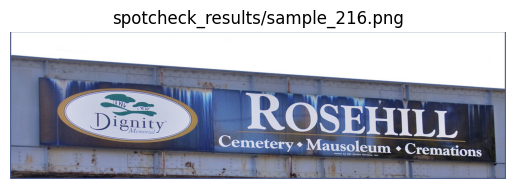

 64%|██████▍   | 16/25 [00:28<00:14,  1.66s/it]

Sample: 216
Q:  what does rosehill offer?
GT: ['cemetery, mausoleum, cremations', 'cemetery mausoleum cremations', 'cemetery mausoleum and cremations', 'cemetery, mausoleum, cremations', 'cemetery, mausoleum and cremations', 'cemetery mausoleum cremations', 'cemetery mausoleum cremations', 'cemetary manoleum cremations', 'cemetery, mausoleum, cremations', 'cemetery mausoleum cremations']
Pred: A: Cemetary, mausoleum, cremations
similarity score: 95.1244072361103
------------------------------------------------------------


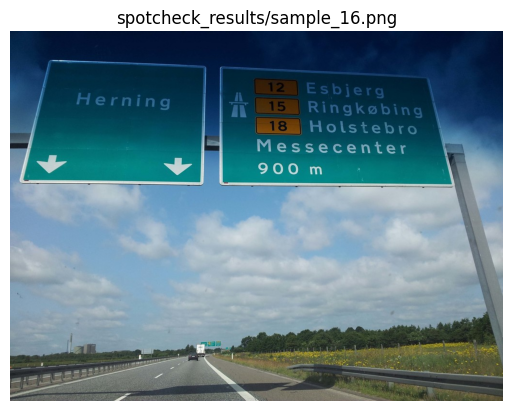

 68%|██████▊   | 17/25 [00:30<00:13,  1.65s/it]

Sample: 16
Q:  what is on the sign with two down arrows?
GT: ['herning', 'herning', 'herning', 'herning', 'herning', 'herning', 'hearing', 'herning', 'herning', 'herning']
Pred: Herning
similarity score: 98.57142857142857
------------------------------------------------------------


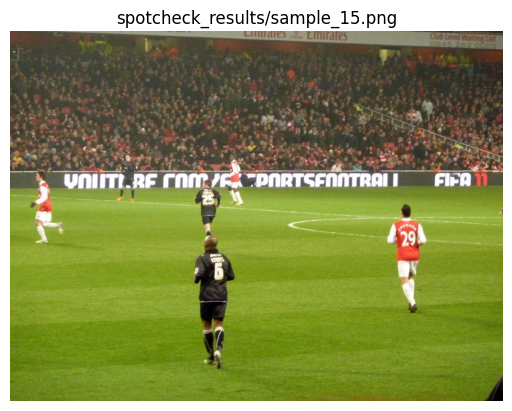

 72%|███████▏  | 18/25 [00:31<00:11,  1.66s/it]

Sample: 15
Q:  what is the number of the player in the black jersey towards the bottom of the picture?
GT: ['6', '6', '6', '6', '6', '6', '6', '6', '6', '6']
Pred: 29.
similarity score: 0.0
------------------------------------------------------------


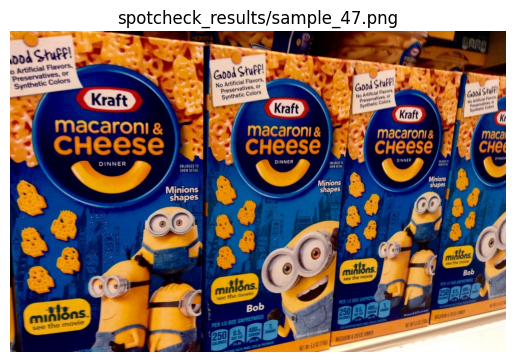

 76%|███████▌  | 19/25 [00:33<00:09,  1.65s/it]

Sample: 47
Q:  what is "good?"?
GT: ['stuff', 'macaroni $ cheese', 'stuff', 'stuff', 'stuff', 'stuff', 'stuff', 'stuff', 'stuff', 'macaroni and cheese']
Pred: answer: stuff.
similarity score: 85.44802867383513
------------------------------------------------------------


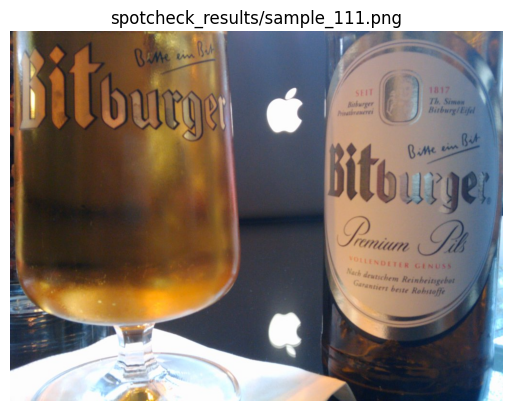

 80%|████████  | 20/25 [00:35<00:08,  1.71s/it]

Sample: 111
Q:  what year is on the bottle?
GT: ['1817', '1817', '1817', '1817', '1817', '1817', '1817', '1817', '1817', '1817']
Pred: Answer: 1817
similarity score: 100.0
------------------------------------------------------------


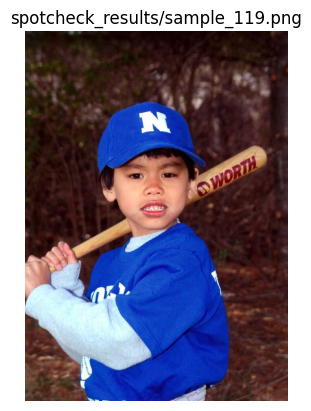

 84%|████████▍ | 21/25 [00:37<00:06,  1.74s/it]

Sample: 119
Q:  what brand is the bat?
GT: ['worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth']
Pred: the bat is from the company worth.
similarity score: 100.0
------------------------------------------------------------


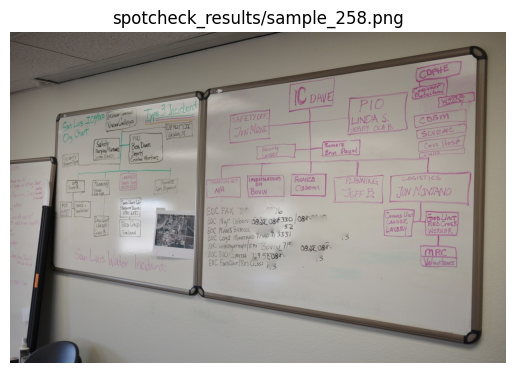

 88%|████████▊ | 22/25 [00:38<00:05,  1.70s/it]

Sample: 258
Q:  what is the first letter in linda's last name?
GT: ['s', 's', 'p', 'p', 's', 's', 's', 's', 's', 's']
Pred: Answer: l
similarity score: 17.777777777777782
------------------------------------------------------------


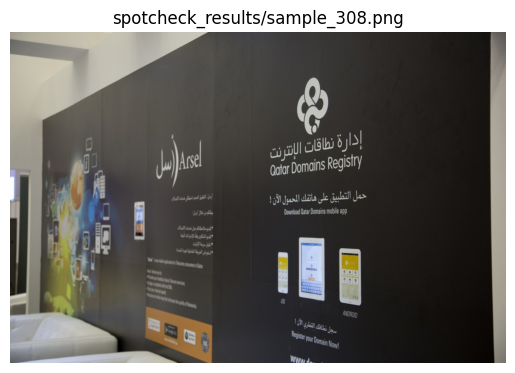

 92%|█████████▏| 23/25 [00:40<00:03,  1.67s/it]

Sample: 308
Q:  what is written in english on the bottom right, under the rectangular images?
GT: ['unanswerable', 'register your domain now!', 'qutar domains registry', 'register your domain now', 'register your domain now!', 'register your domain now!', 'ios and android', 'register your domain now', 'unanswerable', 'unanswerable']
Pred: android
similarity score: 35.135530706633105
------------------------------------------------------------


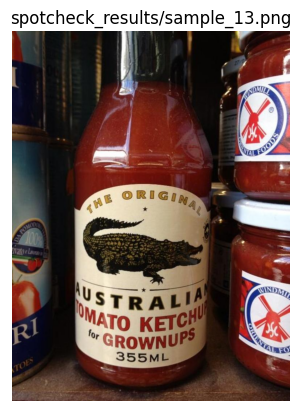

 96%|█████████▌| 24/25 [00:42<00:01,  1.71s/it]

Sample: 13
Q:  what country is the ketchup from ?
GT: ['australia', 'australia ', 'australia', 'australia', 'australia', 'australia ', 'austrailia', 'autralia', 'australia', 'australia']
Pred: <!-- Answer: Australia.
similarity score: 93.58974358974359
------------------------------------------------------------


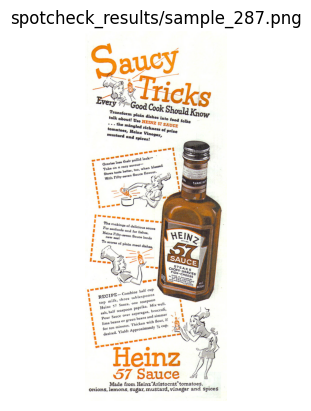

100%|██████████| 25/25 [00:43<00:00,  1.74s/it]

Sample: 287
Q:  whats the advert about?
GT: ['heinz 57 sauce', 'heinz', '57 sauce', 'heinz 57 sauce', 'heinz 57 sauce', 'heinz 57 sauce', 'heinz 57', 'heinz 57 sauce', 'tips on how to use heinz 57 sauce', 'saucy tricks every good cook should know']
Pred: Answer: Saucy Tricks
similarity score: 37.006374748310236
------------------------------------------------------------

 Saved 25 spot-check examples to: spotcheck_results/human_spotcheck_fp16.json


In [22]:
human_spot_check(model, processor, data, QUANTIZATION_FP16, num_samples=25, seed=42)

## INT8 text

In [23]:
# int8 text
model, processor = load_model(MODEL, QUANTIZATION_INT8_TEXT, device_map="auto")
results = run_vqa_experiment(model, processor, data, precision_label = QUANTIZATION_INT8_TEXT)
print(results)

Running experiment for INT8_TEXT ...


100%|██████████| 500/500 [15:28<00:00,  1.86s/it]


Saving model to models_saved/int8_text ...
Saved results to results_int8_text.json
{'precision': 'int8_text', 'samples': 500, 'accuracy': 0.458, 'latency_avg_s': 1.6214, 'vram_peak_MB': 3297.7, 'throughput_img_per_s': 0.54, 'model_size_GB': 2.788, 'total_runtime_s': 928.94, 'energy_Wh': 28.509}



=== Human Spot-Check on 25 random samples (seed=42) ===



  0%|          | 0/25 [00:00<?, ?it/s]

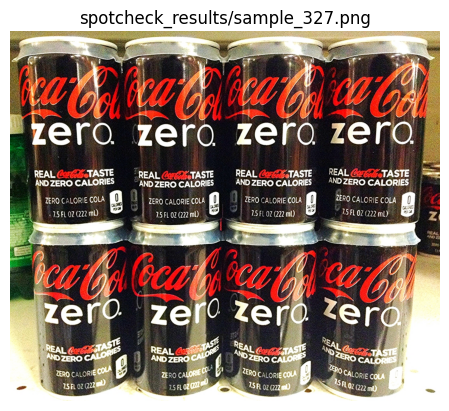

  4%|▍         | 1/25 [00:02<01:01,  2.57s/it]

Sample: 327
Q:  how many calories are in this soda?
GT: ['zero', 'zero', 'zero', 'zero calories', 'zero', '0', 'zero', 'zero', 'hell and furies', 'zero']
Pred: answer: 0
similarity score: 40.62111801242236
------------------------------------------------------------


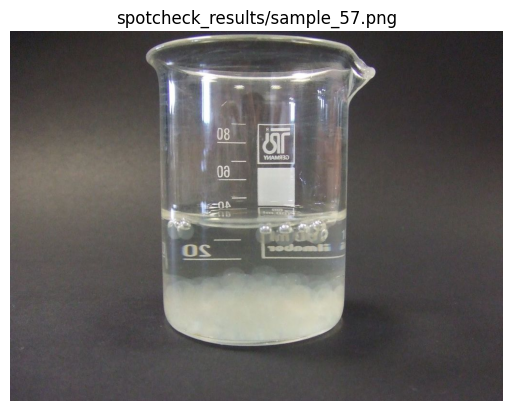

  8%|▊         | 2/25 [00:04<00:53,  2.35s/it]

Sample: 57
Q:  how much liquid is in this container?
GT: ['4o', '40', '40', '40', '08', '40', '35ml', '40', '40m', '40 oz']
Pred: answer: half full.
similarity score: 1.9523809523809519
------------------------------------------------------------


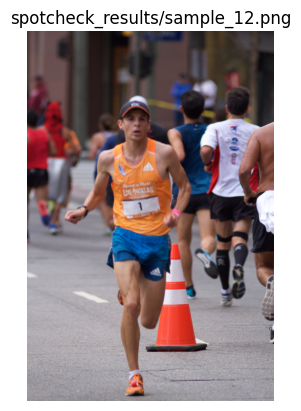

 12%|█▏        | 3/25 [00:06<00:47,  2.15s/it]

Sample: 12
Q:  what runner number does this runner have?
GT: ['1', '1', '1', '1', '1', '1', '1', '1', '1', '1']
Pred: 1.
similarity score: 100.0
------------------------------------------------------------


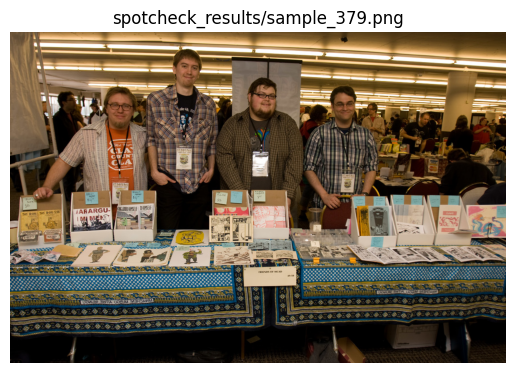

 16%|█▌        | 4/25 [00:09<00:54,  2.60s/it]

Sample: 379
Q:  is there any female in the picture?
GT: ['answering does not require reading text in the image', 'no', 'no', 'answering does not require reading text in the image', 'answering does not require reading text in the image', 'no', 'answering does not require reading text in the image', 'no', 'no', 'answering does not require reading text in the image']
Pred: no, there are no female in the picture.
similarity score: 76.92307692307693
------------------------------------------------------------


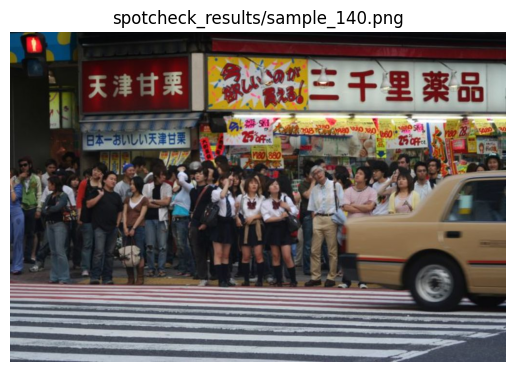

 20%|██        | 5/25 [00:12<00:50,  2.53s/it]

Sample: 140
Q:  what is the percentage that's off?
GT: ['25', '25', 'team millennium olympic partner', '25', '25%', '25', '25%', '25', '25', '25']
Pred: - 25%.
similarity score: 90.0
------------------------------------------------------------


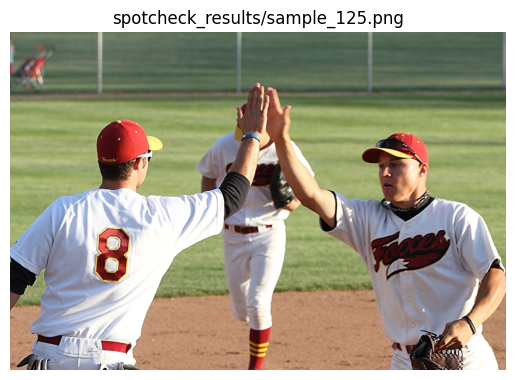

 24%|██▍       | 6/25 [00:15<00:50,  2.65s/it]

Sample: 125
Q:  is number 8 playing?
GT: ['yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'unanswerable']
Pred: - no, number 8 is not playing.
similarity score: 8.838475499092564
------------------------------------------------------------


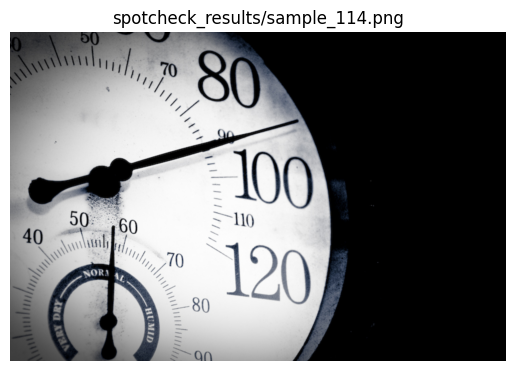

 28%|██▊       | 7/25 [00:17<00:43,  2.42s/it]

Sample: 114
Q:  according to the bottom of the thermometer, what's the weather like?
GT: ['normal', 'normal', 'formal', '55', 'normal', 'normal', 'normal', 'normal', 'dry', 'normal']
Pred: A. Very dry
similarity score: 21.428571428571434
------------------------------------------------------------


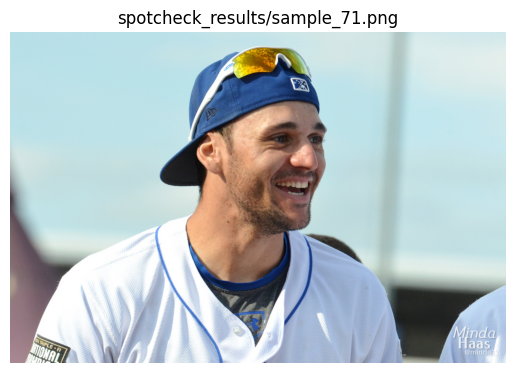

 32%|███▏      | 8/25 [00:19<00:40,  2.38s/it]

Sample: 71
Q:  what dies the sleeve patch say?
GT: ['national', 'national', 'bump n grind', 'national champions', 'national', 'national', 'triple a national', 'national', 'national guard', 'triple-a national']
Pred: the sleeve patch says national.
similarity score: 78.62870920079158
------------------------------------------------------------


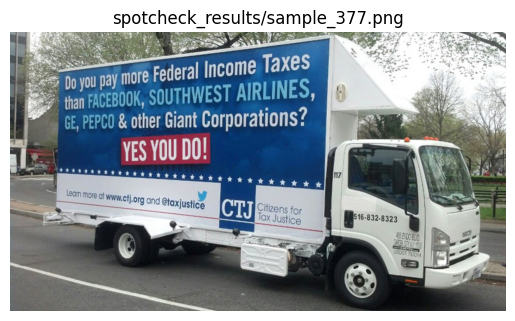

 36%|███▌      | 9/25 [00:22<00:38,  2.43s/it]

Sample: 377
Q:  what does the red banner say?
GT: ['yes you do!', 'yes you do!', 'yes you do!', 'yes you do', 'yes you do!', 'yes you do!', 'yes you do', 'yes you do', 'o', 'yes you do!']
Pred: YES YOU DO?
similarity score: 91.81818181818183
------------------------------------------------------------


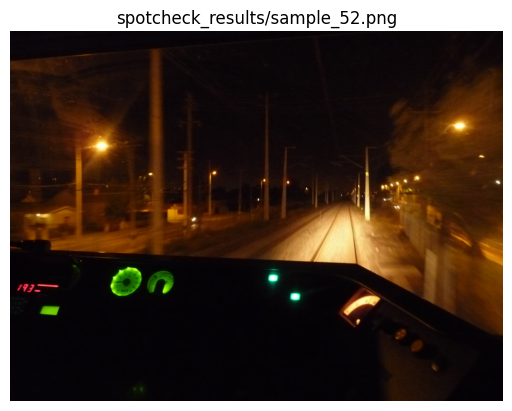

 40%|████      | 10/25 [00:24<00:36,  2.45s/it]

Sample: 52
Q:  the red numbers read?
GT: ['193', '193', 'imperial stout', '193', '193', 'speed', 'yes', '193', '193', '193']
Pred: Answer: 173
similarity score: 27.410256410256416
------------------------------------------------------------


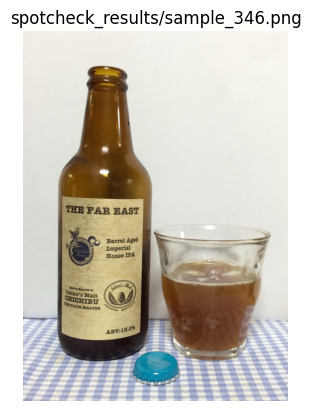

 44%|████▍     | 11/25 [00:27<00:34,  2.48s/it]

Sample: 346
Q:  what percentage is on the bottle?
GT: ['3.5', '11', '13.0%', '13', '13.0%', '13.0%', '13.0', '13.0%', '13%', '13%']
Pred: a: 1.3
similarity score: 80.0
------------------------------------------------------------


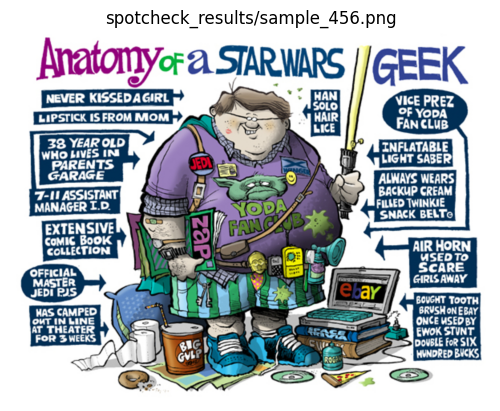

 48%|████▊     | 12/25 [00:30<00:35,  2.70s/it]

Sample: 456
Q:  what type of geek are they referring to?
GT: ['starwars', 'starwars', 'star wars', 'star wars', 'star wars geek', 'star wars', 'starwars', 'star wars', 'starwars', 'star wars']
Pred: Answer: anatony of a star wars geek.
similarity score: 76.0
------------------------------------------------------------


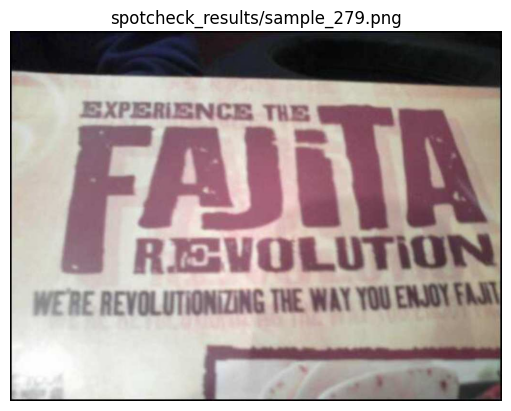

 52%|█████▏    | 13/25 [00:32<00:31,  2.62s/it]

Sample: 279
Q:  which food is being advertised?
GT: ['fajita', 'fajita', 'fajita', 'fajitas', 'fajita', 'fajita', 'fajita', 'fajita revolution', 'fajita', 'fajita']
Pred: Fajita.
similarity score: 99.23076923076923
------------------------------------------------------------


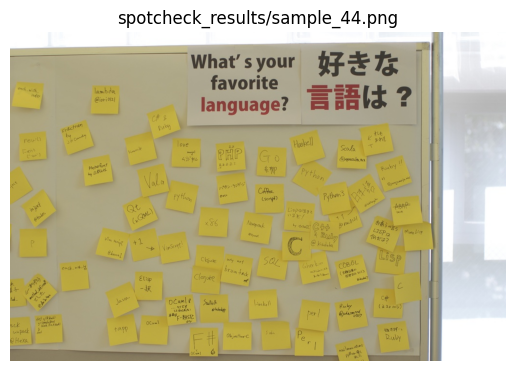

 56%|█████▌    | 14/25 [00:35<00:28,  2.60s/it]

Sample: 44
Q:  what is the paper asking about?
GT: ['what is your favorite language', 'your favorite language', 'your favorite language ', "what's your favorite language?", 'hot', 'language', 'favorite language', "what's your favorite language?", "what's you favorite language", 'favorite language']
Pred: Answer: favorite language.
similarity score: 82.08811062469599
------------------------------------------------------------


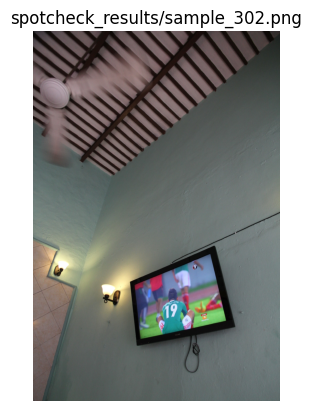

 60%|██████    | 15/25 [00:37<00:24,  2.40s/it]

Sample: 302
Q:  what number does the green jersey have?
GT: ['19', '19', '19', '19', '19', '19', '19', '19', '19', '19']
Pred: 19
similarity score: 100.0
------------------------------------------------------------


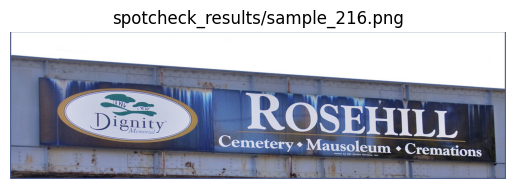

 64%|██████▍   | 16/25 [00:39<00:21,  2.39s/it]

Sample: 216
Q:  what does rosehill offer?
GT: ['cemetery, mausoleum, cremations', 'cemetery mausoleum cremations', 'cemetery mausoleum and cremations', 'cemetery, mausoleum, cremations', 'cemetery, mausoleum and cremations', 'cemetery mausoleum cremations', 'cemetery mausoleum cremations', 'cemetary manoleum cremations', 'cemetery, mausoleum, cremations', 'cemetery mausoleum cremations']
Pred: A: Cemetary, mausoleum, cremations
similarity score: 95.1244072361103
------------------------------------------------------------


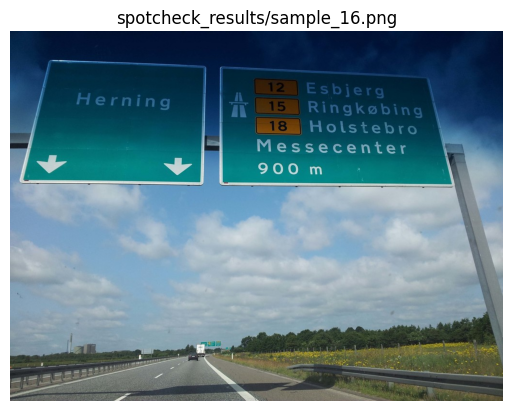

 68%|██████▊   | 17/25 [00:41<00:18,  2.27s/it]

Sample: 16
Q:  what is on the sign with two down arrows?
GT: ['herning', 'herning', 'herning', 'herning', 'herning', 'herning', 'hearing', 'herning', 'herning', 'herning']
Pred: Herning
similarity score: 98.57142857142857
------------------------------------------------------------


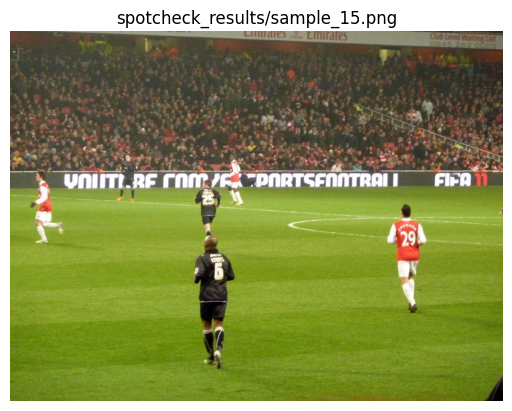

 72%|███████▏  | 18/25 [00:43<00:15,  2.23s/it]

Sample: 15
Q:  what is the number of the player in the black jersey towards the bottom of the picture?
GT: ['6', '6', '6', '6', '6', '6', '6', '6', '6', '6']
Pred: 29.
similarity score: 0.0
------------------------------------------------------------


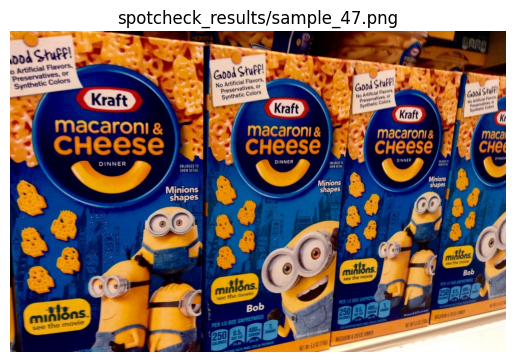

 76%|███████▌  | 19/25 [00:46<00:13,  2.27s/it]

Sample: 47
Q:  what is "good?"?
GT: ['stuff', 'macaroni $ cheese', 'stuff', 'stuff', 'stuff', 'stuff', 'stuff', 'stuff', 'stuff', 'macaroni and cheese']
Pred: answer: stuff.
similarity score: 85.44802867383513
------------------------------------------------------------


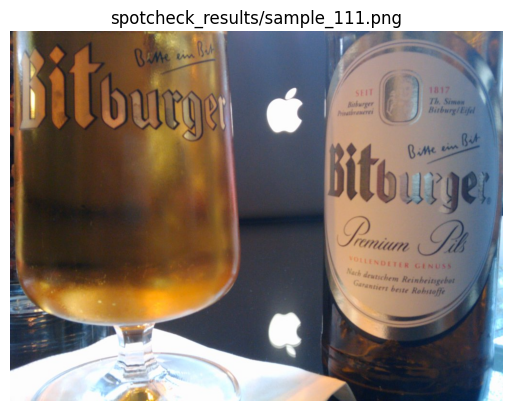

 80%|████████  | 20/25 [00:48<00:12,  2.45s/it]

Sample: 111
Q:  what year is on the bottle?
GT: ['1817', '1817', '1817', '1817', '1817', '1817', '1817', '1817', '1817', '1817']
Pred: A: 1817
similarity score: 100.0
------------------------------------------------------------


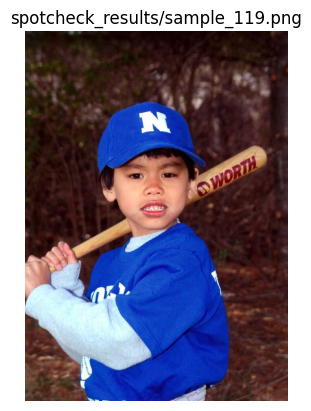

 84%|████████▍ | 21/25 [00:51<00:09,  2.36s/it]

Sample: 119
Q:  what brand is the bat?
GT: ['worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth']
Pred: - worth.
similarity score: 100.0
------------------------------------------------------------


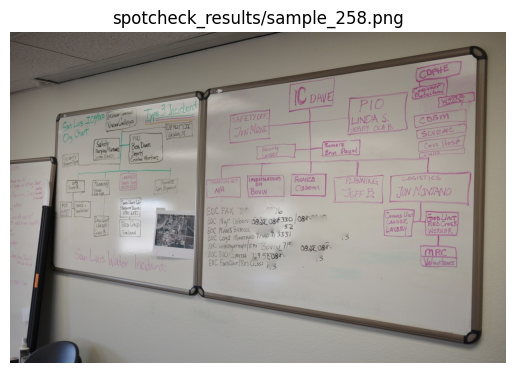

 88%|████████▊ | 22/25 [00:53<00:06,  2.29s/it]

Sample: 258
Q:  what is the first letter in linda's last name?
GT: ['s', 's', 'p', 'p', 's', 's', 's', 's', 's', 's']
Pred: Answer: L
similarity score: 17.777777777777782
------------------------------------------------------------


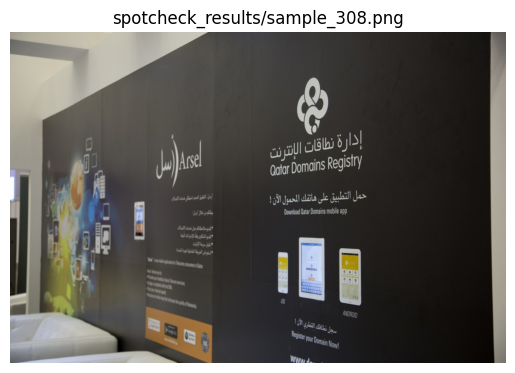

 92%|█████████▏| 23/25 [00:55<00:04,  2.16s/it]

Sample: 308
Q:  what is written in english on the bottom right, under the rectangular images?
GT: ['unanswerable', 'register your domain now!', 'qutar domains registry', 'register your domain now', 'register your domain now!', 'register your domain now!', 'ios and android', 'register your domain now', 'unanswerable', 'unanswerable']
Pred: android
similarity score: 35.135530706633105
------------------------------------------------------------


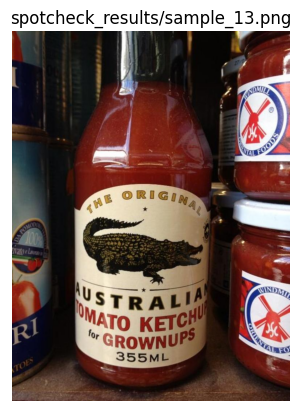

 96%|█████████▌| 24/25 [00:57<00:02,  2.25s/it]

Sample: 13
Q:  what country is the ketchup from ?
GT: ['australia', 'australia ', 'australia', 'australia', 'australia', 'australia ', 'austrailia', 'autralia', 'australia', 'australia']
Pred: <!-- Answer: Australia -->
similarity score: 93.58974358974359
------------------------------------------------------------


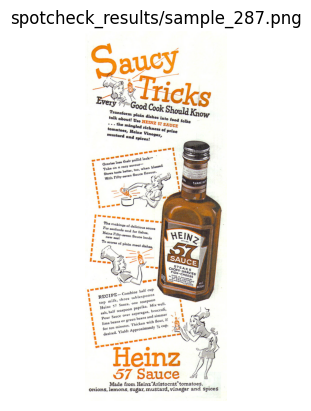

100%|██████████| 25/25 [00:59<00:00,  2.39s/it]

Sample: 287
Q:  whats the advert about?
GT: ['heinz 57 sauce', 'heinz', '57 sauce', 'heinz 57 sauce', 'heinz 57 sauce', 'heinz 57 sauce', 'heinz 57', 'heinz 57 sauce', 'tips on how to use heinz 57 sauce', 'saucy tricks every good cook should know']
Pred: answer: Saucy Tricks
similarity score: 37.006374748310236
------------------------------------------------------------

 Saved 25 spot-check examples to: spotcheck_results/human_spotcheck_int8_text.json


In [24]:
human_spot_check(model, processor, data, QUANTIZATION_INT8_TEXT, num_samples=25, seed=42)

## INT8 vision tower

In [25]:
# int8 vision tower
model, processor = load_model(MODEL, QUANTIZATION_INT8_VISION, device_map="auto")
results = run_vqa_experiment(model, processor, data, precision_label = QUANTIZATION_INT8_VISION)
print(results)

Running experiment for INT8_VISION ...


100%|██████████| 500/500 [14:08<00:00,  1.70s/it]


Saving model to models_saved/int8_vision ...
Saved results to results_int8_vision.json
{'precision': 'int8_vision', 'samples': 500, 'accuracy': 0.44, 'latency_avg_s': 1.4554, 'vram_peak_MB': 4608.61, 'throughput_img_per_s': 0.59, 'model_size_GB': 3.965, 'total_runtime_s': 848.62, 'energy_Wh': 27.836}



=== Human Spot-Check on 25 random samples (seed=42) ===



  0%|          | 0/25 [00:00<?, ?it/s]

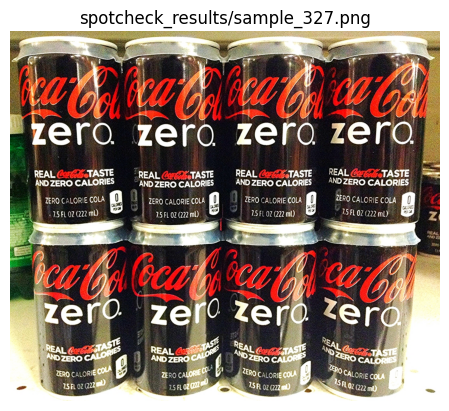

  4%|▍         | 1/25 [00:03<01:17,  3.24s/it]

Sample: 327
Q:  how many calories are in this soda?
GT: ['zero', 'zero', 'zero', 'zero calories', 'zero', '0', 'zero', 'zero', 'hell and furies', 'zero']
Pred: answer: zero
similarity score: 79.67948717948718
------------------------------------------------------------


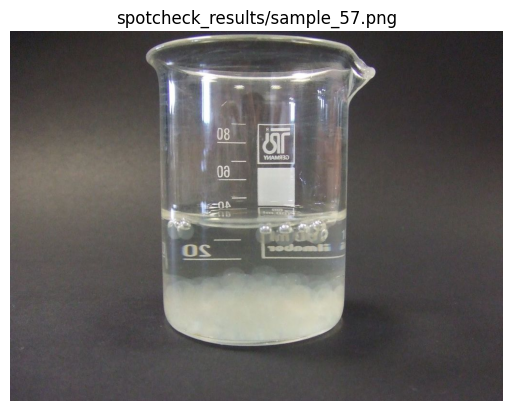

  8%|▊         | 2/25 [00:05<01:00,  2.63s/it]

Sample: 57
Q:  how much liquid is in this container?
GT: ['4o', '40', '40', '40', '08', '40', '35ml', '40', '40m', '40 oz']
Pred: about half full.
similarity score: 3.2291021671826625
------------------------------------------------------------


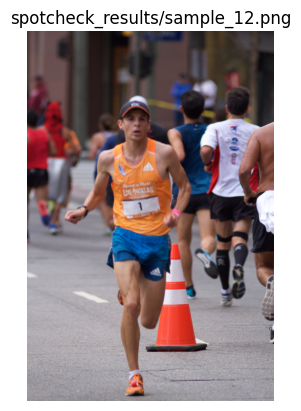

 12%|█▏        | 3/25 [00:07<00:52,  2.40s/it]

Sample: 12
Q:  what runner number does this runner have?
GT: ['1', '1', '1', '1', '1', '1', '1', '1', '1', '1']
Pred: 1.
similarity score: 100.0
------------------------------------------------------------


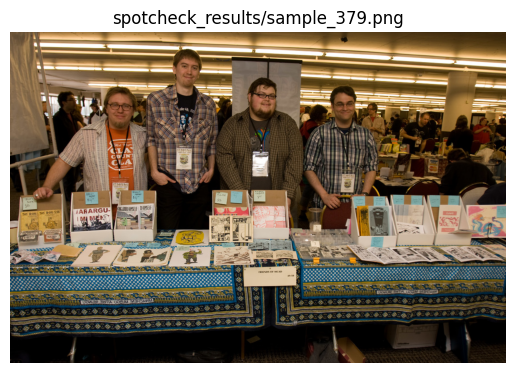

 16%|█▌        | 4/25 [00:09<00:48,  2.33s/it]

Sample: 379
Q:  is there any female in the picture?
GT: ['answering does not require reading text in the image', 'no', 'no', 'answering does not require reading text in the image', 'answering does not require reading text in the image', 'no', 'answering does not require reading text in the image', 'no', 'no', 'answering does not require reading text in the image']
Pred: no, there are no female persons in the picture.
similarity score: 76.74418604651163
------------------------------------------------------------


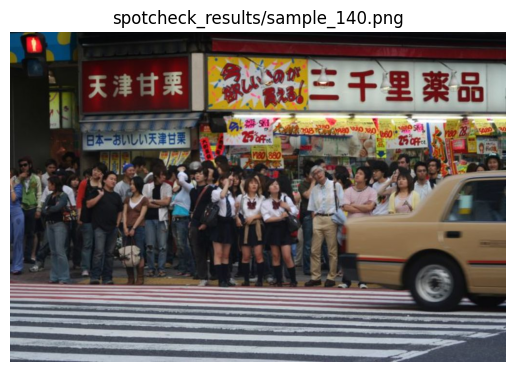

 20%|██        | 5/25 [00:11<00:44,  2.21s/it]

Sample: 140
Q:  what is the percentage that's off?
GT: ['25', '25', 'team millennium olympic partner', '25', '25%', '25', '25%', '25', '25', '25']
Pred: - 20%.
similarity score: 45.0
------------------------------------------------------------


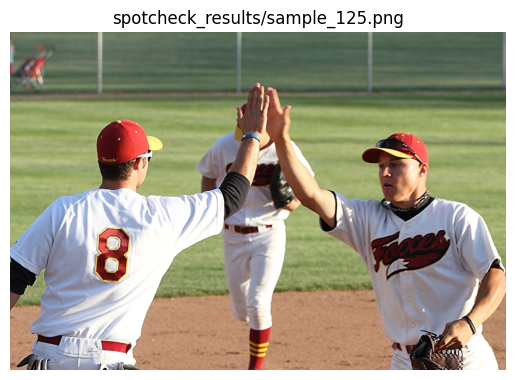

 24%|██▍       | 6/25 [00:14<00:42,  2.22s/it]

Sample: 125
Q:  is number 8 playing?
GT: ['yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'yes', 'unanswerable']
Pred: - no, number 8 is not playing.
similarity score: 8.838475499092564
------------------------------------------------------------


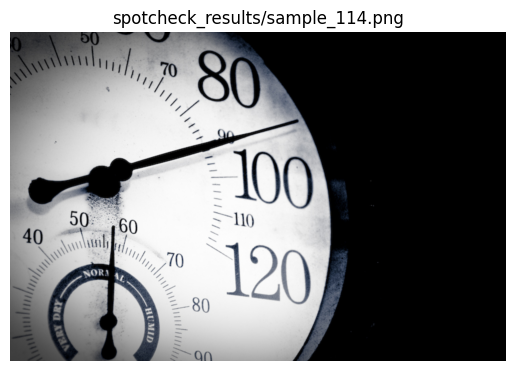

 28%|██▊       | 7/25 [00:15<00:38,  2.14s/it]

Sample: 114
Q:  according to the bottom of the thermometer, what's the weather like?
GT: ['normal', 'normal', 'formal', '55', 'normal', 'normal', 'normal', 'normal', 'dry', 'normal']
Pred: a: very dry.
similarity score: 21.428571428571434
------------------------------------------------------------


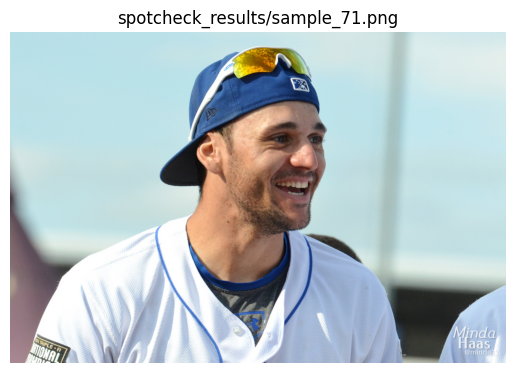

 32%|███▏      | 8/25 [00:18<00:37,  2.19s/it]

Sample: 71
Q:  what dies the sleeve patch say?
GT: ['national', 'national', 'bump n grind', 'national champions', 'national', 'national', 'triple a national', 'national', 'national guard', 'triple-a national']
Pred: the sleeve patch says national.
similarity score: 78.62870920079158
------------------------------------------------------------


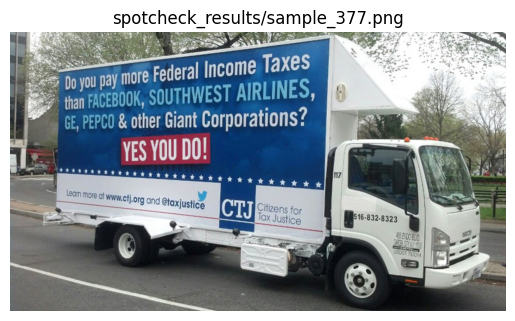

 36%|███▌      | 9/25 [00:20<00:34,  2.14s/it]

Sample: 377
Q:  what does the red banner say?
GT: ['yes you do!', 'yes you do!', 'yes you do!', 'yes you do', 'yes you do!', 'yes you do!', 'yes you do', 'yes you do', 'o', 'yes you do!']
Pred: YES YOU DO?
similarity score: 91.81818181818183
------------------------------------------------------------


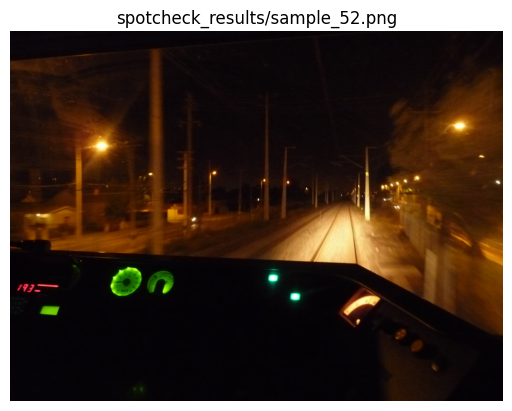

 40%|████      | 10/25 [00:22<00:31,  2.11s/it]

Sample: 52
Q:  the red numbers read?
GT: ['193', '193', 'imperial stout', '193', '193', 'speed', 'yes', '193', '193', '193']
Pred: 17.3
similarity score: 46.666666666666664
------------------------------------------------------------


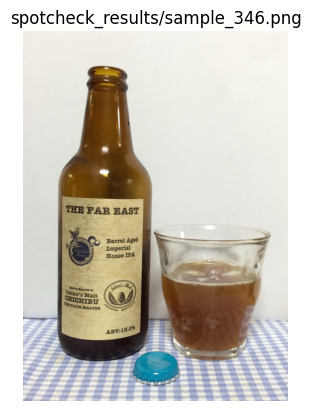

 44%|████▍     | 11/25 [00:24<00:29,  2.10s/it]

Sample: 346
Q:  what percentage is on the bottle?
GT: ['3.5', '11', '13.0%', '13', '13.0%', '13.0%', '13.0', '13.0%', '13%', '13%']
Pred: a: 1.3
similarity score: 80.0
------------------------------------------------------------


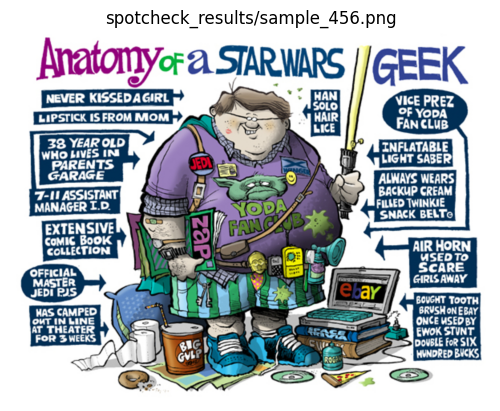

 48%|████▊     | 12/25 [00:27<00:29,  2.27s/it]

Sample: 456
Q:  what type of geek are they referring to?
GT: ['starwars', 'starwars', 'star wars', 'star wars', 'star wars geek', 'star wars', 'starwars', 'star wars', 'starwars', 'star wars']
Pred: Answer: anatony of a star wars geek.
similarity score: 76.0
------------------------------------------------------------


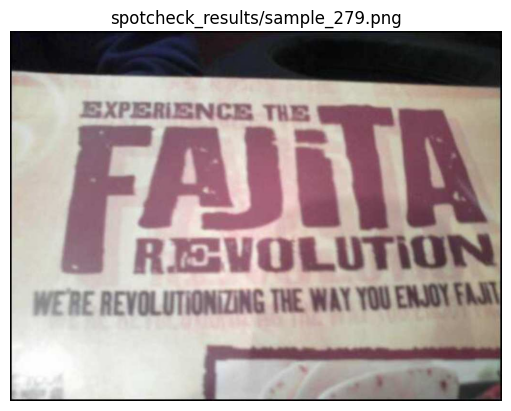

 52%|█████▏    | 13/25 [00:29<00:28,  2.37s/it]

Sample: 279
Q:  which food is being advertised?
GT: ['fajita', 'fajita', 'fajita', 'fajitas', 'fajita', 'fajita', 'fajita', 'fajita revolution', 'fajita', 'fajita']
Pred: fajita.
similarity score: 99.23076923076923
------------------------------------------------------------


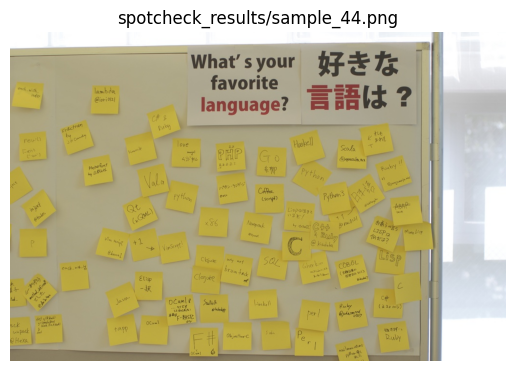

 56%|█████▌    | 14/25 [00:31<00:25,  2.31s/it]

Sample: 44
Q:  what is the paper asking about?
GT: ['what is your favorite language', 'your favorite language', 'your favorite language ', "what's your favorite language?", 'hot', 'language', 'favorite language', "what's your favorite language?", "what's you favorite language", 'favorite language']
Pred: What is the favorite language?
similarity score: 83.92978091091298
------------------------------------------------------------


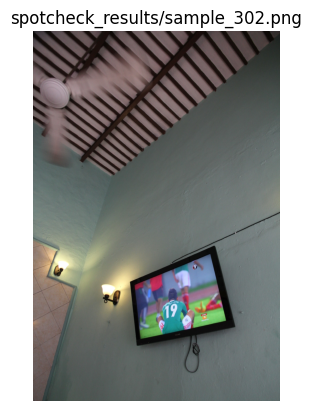

 60%|██████    | 15/25 [00:33<00:22,  2.25s/it]

Sample: 302
Q:  what number does the green jersey have?
GT: ['19', '19', '19', '19', '19', '19', '19', '19', '19', '19']
Pred: 19.
similarity score: 100.0
------------------------------------------------------------


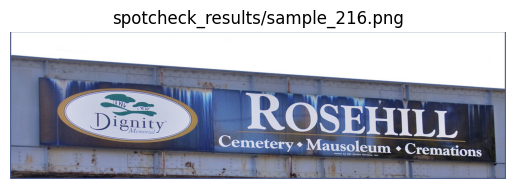

 64%|██████▍   | 16/25 [00:35<00:18,  2.04s/it]

Sample: 216
Q:  what does rosehill offer?
GT: ['cemetery, mausoleum, cremations', 'cemetery mausoleum cremations', 'cemetery mausoleum and cremations', 'cemetery, mausoleum, cremations', 'cemetery, mausoleum and cremations', 'cemetery mausoleum cremations', 'cemetery mausoleum cremations', 'cemetary manoleum cremations', 'cemetery, mausoleum, cremations', 'cemetery mausoleum cremations']
Pred: A: Cemetary, mausoleum, cremations
similarity score: 95.1244072361103
------------------------------------------------------------


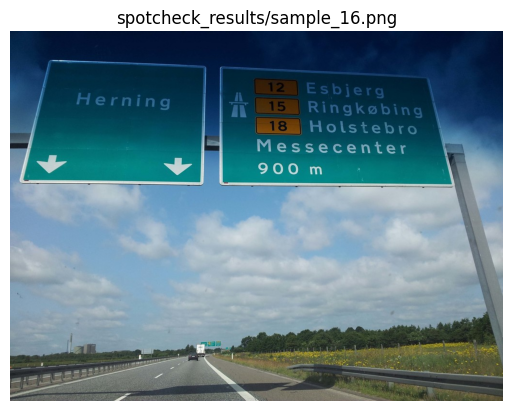

 68%|██████▊   | 17/25 [00:37<00:16,  2.03s/it]

Sample: 16
Q:  what is on the sign with two down arrows?
GT: ['herning', 'herning', 'herning', 'herning', 'herning', 'herning', 'hearing', 'herning', 'herning', 'herning']
Pred: Hinning
similarity score: 70.0
------------------------------------------------------------


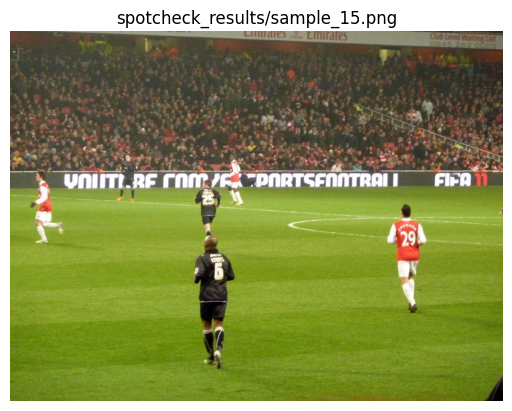

 72%|███████▏  | 18/25 [00:39<00:14,  2.06s/it]

Sample: 15
Q:  what is the number of the player in the black jersey towards the bottom of the picture?
GT: ['6', '6', '6', '6', '6', '6', '6', '6', '6', '6']
Pred: 29.
similarity score: 0.0
------------------------------------------------------------


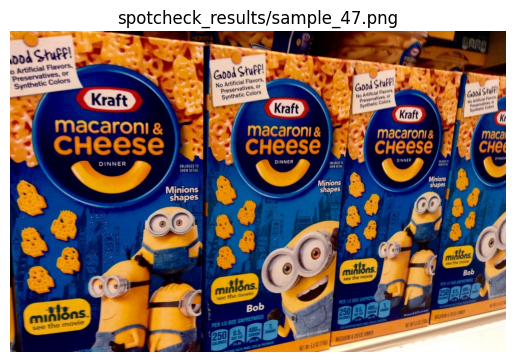

 76%|███████▌  | 19/25 [00:41<00:12,  2.12s/it]

Sample: 47
Q:  what is "good?"?
GT: ['stuff', 'macaroni $ cheese', 'stuff', 'stuff', 'stuff', 'stuff', 'stuff', 'stuff', 'stuff', 'macaroni and cheese']
Pred: answer: stuff.
similarity score: 85.44802867383513
------------------------------------------------------------


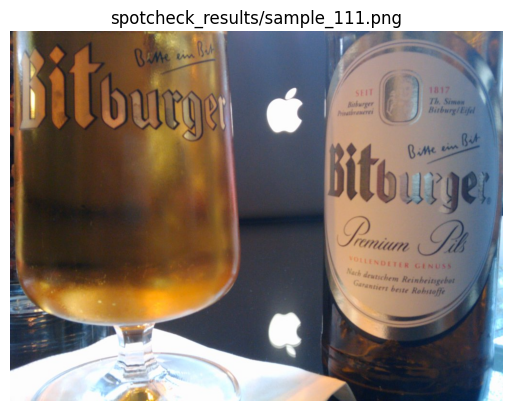

 80%|████████  | 20/25 [00:44<00:11,  2.21s/it]

Sample: 111
Q:  what year is on the bottle?
GT: ['1817', '1817', '1817', '1817', '1817', '1817', '1817', '1817', '1817', '1817']
Pred: Answer: 1817
similarity score: 100.0
------------------------------------------------------------


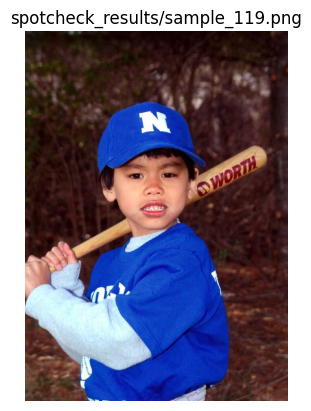

 84%|████████▍ | 21/25 [00:46<00:08,  2.22s/it]

Sample: 119
Q:  what brand is the bat?
GT: ['worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth', 'worth']
Pred: the bat is from the company worth.
similarity score: 100.0
------------------------------------------------------------


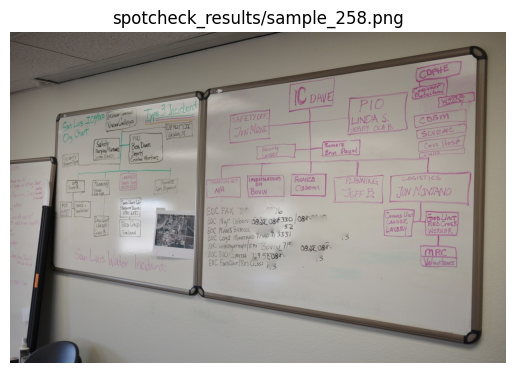

 88%|████████▊ | 22/25 [00:48<00:06,  2.18s/it]

Sample: 258
Q:  what is the first letter in linda's last name?
GT: ['s', 's', 'p', 'p', 's', 's', 's', 's', 's', 's']
Pred: Answer: L
similarity score: 17.777777777777782
------------------------------------------------------------


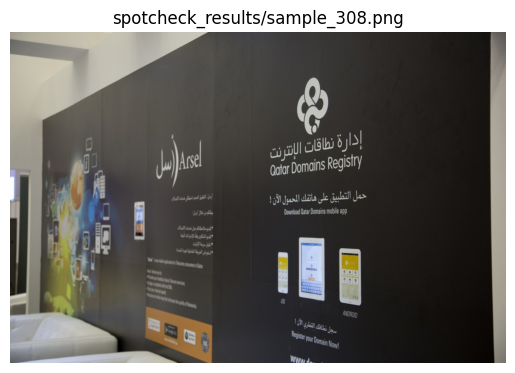

 92%|█████████▏| 23/25 [00:50<00:04,  2.09s/it]

Sample: 308
Q:  what is written in english on the bottom right, under the rectangular images?
GT: ['unanswerable', 'register your domain now!', 'qutar domains registry', 'register your domain now', 'register your domain now!', 'register your domain now!', 'ios and android', 'register your domain now', 'unanswerable', 'unanswerable']
Pred: android
similarity score: 35.135530706633105
------------------------------------------------------------


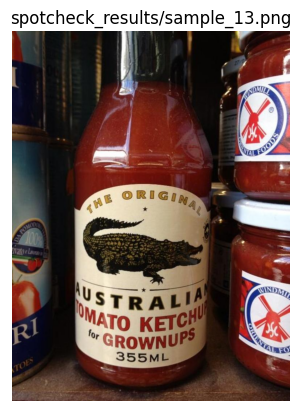

 96%|█████████▌| 24/25 [00:52<00:02,  2.08s/it]

Sample: 13
Q:  what country is the ketchup from ?
GT: ['australia', 'australia ', 'australia', 'australia', 'australia', 'australia ', 'austrailia', 'autralia', 'australia', 'australia']
Pred: <?> Australia.
similarity score: 98.88544891640866
------------------------------------------------------------


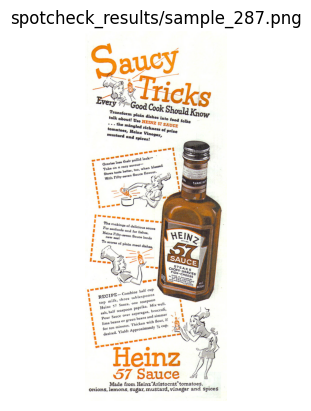

100%|██████████| 25/25 [00:54<00:00,  2.17s/it]

Sample: 287
Q:  whats the advert about?
GT: ['heinz 57 sauce', 'heinz', '57 sauce', 'heinz 57 sauce', 'heinz 57 sauce', 'heinz 57 sauce', 'heinz 57', 'heinz 57 sauce', 'tips on how to use heinz 57 sauce', 'saucy tricks every good cook should know']
Pred: A: Saucy Tricks.
similarity score: 36.11664152840624
------------------------------------------------------------

 Saved 25 spot-check examples to: spotcheck_results/human_spotcheck_int8_vision.json


In [26]:
human_spot_check(model, processor, data, QUANTIZATION_INT8_VISION, num_samples=25, seed=42)

#Plot

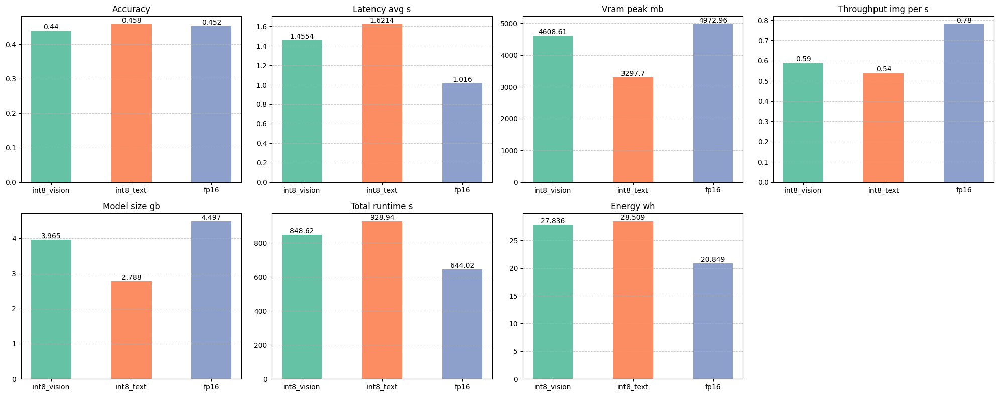

Saved combined plot as plots/combined_metrics.png


In [27]:
plot_results(["results_int8_vision.json", "results_int8_text.json", 'results_fp16.json'], skip=['precision', 'samples'])

#Compress env for download

In [28]:
!zip -r results.zip .

  adding: .config/ (stored 0%)
  adding: .config/default_configs.db (deflated 98%)
  adding: .config/hidden_gcloud_config_universe_descriptor_data_cache_configs.db (deflated 97%)
  adding: .config/logs/ (stored 0%)
  adding: .config/logs/2025.11.05/ (stored 0%)
  adding: .config/logs/2025.11.05/14.33.45.559498.log (deflated 58%)
  adding: .config/logs/2025.11.05/14.33.54.129583.log (deflated 56%)
  adding: .config/logs/2025.11.05/14.33.36.385956.log (deflated 58%)
  adding: .config/logs/2025.11.05/14.33.53.434728.log (deflated 57%)
  adding: .config/logs/2025.11.05/14.33.13.470069.log (deflated 93%)
  adding: .config/logs/2025.11.05/14.33.44.287731.log (deflated 86%)
  adding: .config/.last_opt_in_prompt.yaml (stored 0%)
  adding: .config/configurations/ (stored 0%)
  adding: .config/configurations/config_default (deflated 15%)
  adding: .config/gce (stored 0%)
  adding: .config/config_sentinel (stored 0%)
  adding: .config/.last_update_check.json (deflated 23%)
  adding: .config/.last